# Avaliação  Projeto II: Projeto em Python
## **Tarefa**:
#### Utilizando a linguagem de programacão Python escreva e execute um programa que seja capaz de realizar as seguintes tarefas:
1. Carregar arquivos de áudio em formato wave de um diretório especificado;
2. Indexar cada arquivo de forma numérica (o primeiro arquivo do diretório será o “1.wav”, o segundo “2.wav” e assim por diante);
3. Realizar o _downmixing_ de cada arquivo (transformar o arquivo estéreo em mono);
4. Exibir o gráfico em fução do tempo de um arquivo a ser especificado pelo usuário;
5. Sugira outra funcionalidade para tornar o seu projeto original.

## Descrição:
#### **Formato WAVE**
_Waveform Audio File format_, _WAVE_, _WAV_ é um formato de áudio padrão desenvolvido pela IBM e Microsoft para armazenar um fluxo de bits de áudio em PCs. Esse fluxo de bits é condificado por modulação por código de pulso ([PCM](https://pt.wikipedia.org/wiki/Modula%C3%A7%C3%A3o_por_c%C3%B3digo_de_pulsos)).

É uma variação do método de formatação de fluxo de bits RIFF para armazenar dados em blocos (chunks) e também parecido com os formatos IFF e o AIFF usados em computadores Macintosh. São levadas em conta algumas diferenças nos processadores Intel como a ordem de bytes "little-endian". O formato RIFF age como um "empacotador" (wrapper) para vários codecs de compressão de áudio. É o principal formato usado nos sistemas Windows para áudio simples. 

<img src="imagens/wave_file_format.jpeg" alt="wave format" width="500" />

#### **Importando os pacotes utilizados para o processamento do áudio**

In [29]:
from glob import glob
from datetime import timedelta
from IPython.display import display, Audio
import ipywidgets as widgets 
from scipy.io.wavfile import read, write
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
from pyAudioProcessing.run_classification import train_and_classify

ValueError: sklearn.tree._tree.TreeBuilder size changed, may indicate binary incompatibility. Expected 80 from C header, got 72 from PyObject

#### **Definindo os valores das variáveis usadas no programa**

In [2]:
ndir    = 'wave_files/'                 # String com o nome da pasta com os arquivos wave
wave_d  = {}                            # Dicionário preenchido com os dados dos arquivos .wav
path_l  = sorted(glob(ndir + '*.wav'))  # Lista com os caminhos relativos de todos os arquivos .wav

#### **Carregando e indexando os arquivos .wav presentes na pasta**
- Fórmula de cálculo da duração em segundos do arquivo wave é: 
    $$t_{ar} = \frac{tamanho_{ar}}{frequencia_{ar}}$$
- Sendo um array que armazena o valor de um canal de áudio $ar$ e a duração em segundo do áudio $t$.

In [3]:
c       = 1                                        # Contador
for file in path_l:
    fname = file.split('/')[-1]                    # Nome do arquivo
    fr, data = read(file)                          # fr armazena o valor de "sample rate" do arquivo e data os arrays com os dados de audio
    time = timedelta(seconds=round(len(data)/fr))  # Calculo da duração do áudio

    # Determinando a quantidade de canais pela dimensão ndarray 
    if data.ndim >= 2:
        sType = 'estéreo'
    else:
        sType = 'mono'   
       
    # Indexando os dados e os dados e metadados dos arquivos .wav em um dicionário
    wave_d[f'{c}.wav'] = {'fileName' : fname,
                          'frequency': fr,
                          'soundType': sType,
                          'data'     : data,
                          'duration' : time}
    
    c += 1

#### **Printando as Informações dos arquivos lidos**

In [4]:
print('Arquivos no formato wave lidos:')

# Atribuição dos valores das keys do dicionários wave_d a variáveis que serão usadas posteriormentes
# em string formatada
for key, value in wave_d.items():
    name  = value["fileName"]
    sType = value["soundType"]
    fr    = int(value["frequency"]/1000)
    dr    = value["duration"]
    
    print(f'Nome: {name}:\n Id: {key}, Tipo do som: {sType}, Frequência: {fr}kHz, Duração: {dr}')

Arquivos no formato wave lidos:
Nome: feeling_good.wav:
 Id: 1.wav, Tipo do som: estéreo, Frequência: 48kHz, Duração: 0:03:41
Nome: jonathan_kreisberg.wav:
 Id: 2.wav, Tipo do som: estéreo, Frequência: 48kHz, Duração: 0:07:05
Nome: memory_of_silver.wav:
 Id: 3.wav, Tipo do som: estéreo, Frequência: 48kHz, Duração: 0:03:58


#### **Realizando o _downmixing_ de cada arquivo (transformar o arquivo estéreo em mono)**
- O processo de downmixing consiste basicamente no cálculo de uma média simples, onde cada elemento dos arrays são somados e divididos pela quantidade de arrays presente. Exemplo: Sendo um arquivo 1.wav composto por dois canais de áudio dois arrays com o mesmo tamanho, $ar1(1, 2, 3, 4, ..., n)$ e $ar2(1, 2, 3, 4, ..., n)$ são gerados, ambos são compostos por $n$ valores. O processo de downmixing se por:
 $armono(1) = \frac{ar1(1) + ar2(1)}{2}$, $armono(2) = \frac{ar1(2) + ar2(2)}{2}$, ... $armono(n) = \frac{ar1(n) + ar2(n)}{2}$ .

In [24]:
# Transformando os valores dos arrays multidimensionais em um único array pela soma vetorizada
# dos elementos de cada array e posterior divisião pelo número de array (dimensões)
for key, value in wave_d.items():
    if value['soundType'] == 'estéreo':
        value['monoData'] = value['data'].astype(float).sum(axis=1) / value['data'].ndim
        
        # Criando os arquivos mono
        name  = value["fileName"]
        fr    = value["frequency"]
        mono  = value['monoData']
        write(f"{ndir}mono_{name}", fr, mono)
        
        wave_d[key] = value
                         

#### **Exibindo o gráfico em fução do tempo de um arquivo especificado pelo usuário**

Dropdown(options=('1.wav', '2.wav', '3.wav'), value='1.wav')

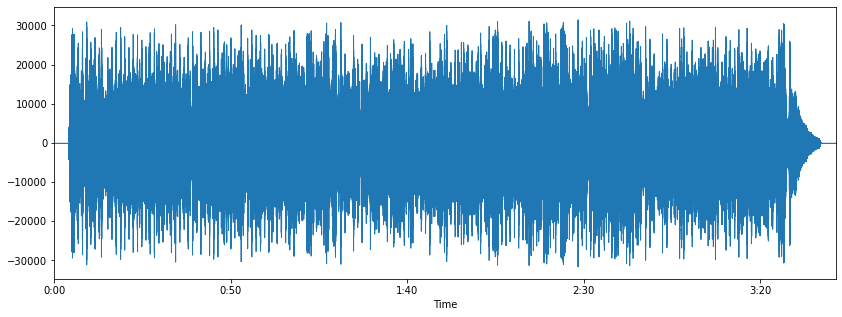

In [6]:
dropdown_ids = widgets.Dropdown(options = wave_d.keys())
display(dropdown_ids)
s = wave_d[dropdown_ids.value]
plt.figure(figsize=(14, 5))
librosa.display.waveplot(s['monoData'], s['frequency'])

display(Audio(s['monoData'], rate=s['frequency']))

#### **Classificação do gênero musical pela bibliotca pyAudioProcessing**

##### pyAudioProcessing
![pyaudioprocessing](https://user-images.githubusercontent.com/16875926/131924198-e34abe7e-12d8-41f9-926d-db199734dcaa.png)

A Python based library for processing audio data into features (GFCC, MFCC, spectral, chroma) and building Machine Learning models.  